In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [4]:
from google.colab import files
uploaded = files.upload()

Saving offseason_merch.csv to offseason_merch.csv


In [5]:
LobsterLand = pd.read_csv('offseason_merch.csv')
print(LobsterLand)

      invoice_num  larry_lobs  larry_cost  short_tee  short_tee_cost  \
0               1           0        0.00          2           23.98   
1               2           5       29.95          2           23.98   
2               3           1        5.99          2           23.98   
3               4           1        5.99          0            0.00   
4               5           2       11.98          1           11.99   
...           ...         ...         ...        ...             ...   
4795         4796           1        5.99          1           11.99   
4796         4797           2       11.98          1           11.99   
4797         4798           3       17.97          1           11.99   
4798         4799           4       23.96          1           11.99   
4799         4800           2       11.98          2           23.98   

      long_tee  long_tee_cost  baseball_hat  baseball_hat_cost  bucket_hat  \
0            2          31.98             1              

**I. Exploratory Data Analysis: Exploration & Manipulation**

**A. Call the head() function on this dataframe and look at your results.**

In [62]:
LobsterLand.head()

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_state,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total
0,1,0,0.00,2,23.98,2,31.98,1,15.99,1,16.99,2,17.98,ME,USA,0,40,1.5,106.92
1,2,5,29.95,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,NaN,NaN,0,42,1.5,69.92
2,3,1,5.99,2,23.98,0,0.00,1,15.99,0,0.00,1,8.99,Other,USA,1,57,None,54.95
3,4,1,5.99,0,0.00,0,0.00,0,0.00,0,0.00,2,17.98,VT,USA,0,44,None,23.97
4,5,2,11.98,1,11.99,1,15.99,1,15.99,0,0.00,1,8.99,MA,USA,1,46,1.5,64.94


**B. How many rows of the dataset are visible in Jupyter now?**

*5 Rows*

**C. Take a look at the dataset’s shape attribute.**

**a. How many rows, and how many columns, are in this entire dataframe?**

*Rows - 4800, Columns - 19*

**D. Read the dataset description, and take a look at the variables in the dataset**

**a. Which of your variables should be seen as categorical, and which ones should be seen as numeric?**

**Categorical Variables -**

*customer_state, customer_nation, LL_passholder, invoice_num, cardholder_age.*

**Numeric Variables -**

*larry_lobs, larry_cost, short_tee_cost, long_tee_cost, baseball_hat_cost, bucket_hat_cost, sunglasses_cost, coupon_disc, purchase_total, short_tee, long_tee, baseball_hat, bucket_hat, sungalsses.*

**E. Lobster Land management just realized that they forgot a couple of things here. They need your help!**

**a. There is no column here for “Maine Sales Tax” – but there should be one. Add a column for Maine Sales Tax – it should be 5.50% of the purchase_total column**

In [63]:
Maine_Sales_Tax = LobsterLand.purchase_total * 0.055

LobsterLand["MaineSalesTax"] = Maine_Sales_Tax
LobsterLand

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_state,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax
0,1,0,0.00,2,23.98,2,31.98,1,15.99,1,16.99,2,17.98,ME,USA,0,40,1.5,106.92,5.88060
1,2,5,29.95,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,NaN,NaN,0,42,1.5,69.92,3.84560
2,3,1,5.99,2,23.98,0,0.00,1,15.99,0,0.00,1,8.99,Other,USA,1,57,None,54.95,3.02225
3,4,1,5.99,0,0.00,0,0.00,0,0.00,0,0.00,2,17.98,VT,USA,0,44,None,23.97,1.31835
4,5,2,11.98,1,11.99,1,15.99,1,15.99,0,0.00,1,8.99,MA,USA,1,46,1.5,64.94,3.57170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4795,4796,1,5.99,1,11.99,0,0.00,0,0.00,0,0.00,2,17.98,RI,USA,0,43,None,35.96,1.97780
4796,4797,2,11.98,1,11.99,0,0.00,0,0.00,0,0.00,0,0.00,ME,USA,1,45,None,23.97,1.31835
4797,4798,3,17.97,1,11.99,0,0.00,0,0.00,0,0.00,1,8.99,Other,USA,1,40,5.75,38.95,2.14225
4798,4799,4,23.96,1,11.99,2,31.98,0,0.00,0,0.00,0,0.00,Other,USA,0,39,None,67.93,3.73615


**b. There should also be a column here for “grand_total.” grand_total should be the purchase_total, plus the sales tax, minus any coupon that was used. To subtract the coupon amounts you may have to modify the coupon_disc variable.**

In [64]:
LobsterLand1=LobsterLand.replace('None',0)

#Converting coupon_disc column from string to float 
a = LobsterLand1['coupon_disc']
LobsterLand1['coupon_disc'] = pd.to_numeric(a)

In [65]:
#Generating Grand total column
Grand_Total = LobsterLand.purchase_total + LobsterLand.MaineSalesTax - LobsterLand1.coupon_disc

LobsterLand["Grand_Total"] = Grand_Total

LobsterLand

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,...,sunglasses,sunglasses_cost,customer_state,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
0,1,0,0.00,2,23.98,2,31.98,1,15.99,1,...,2,17.98,ME,USA,0,40,1.5,106.92,5.88060,111.30060
1,2,5,29.95,2,23.98,0,0.00,1,15.99,0,...,0,0.00,NaN,NaN,0,42,1.5,69.92,3.84560,72.26560
2,3,1,5.99,2,23.98,0,0.00,1,15.99,0,...,1,8.99,Other,USA,1,57,None,54.95,3.02225,57.97225
3,4,1,5.99,0,0.00,0,0.00,0,0.00,0,...,2,17.98,VT,USA,0,44,None,23.97,1.31835,25.28835
4,5,2,11.98,1,11.99,1,15.99,1,15.99,0,...,1,8.99,MA,USA,1,46,1.5,64.94,3.57170,67.01170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4795,4796,1,5.99,1,11.99,0,0.00,0,0.00,0,...,2,17.98,RI,USA,0,43,None,35.96,1.97780,37.93780
4796,4797,2,11.98,1,11.99,0,0.00,0,0.00,0,...,0,0.00,ME,USA,1,45,None,23.97,1.31835,25.28835
4797,4798,3,17.97,1,11.99,0,0.00,0,0.00,0,...,1,8.99,Other,USA,1,40,5.75,38.95,2.14225,35.34225
4798,4799,4,23.96,1,11.99,2,31.98,0,0.00,0,...,0,0.00,Other,USA,0,39,None,67.93,3.73615,71.66615


**F. Can NaNs in a dataset ever indicate something about an observation? Or do they represent a complete ‘void’ of information?**

**a. If you answered “yes” to the first part of this question, come up with an example of a time when an “NaN” might indicate something about an observation in a dataset. (Note: no Python code is required to answer this, and this question is not connected to anything else in this dataset).**

*NaN indicates null value or no data but it might contain prominent information and indicating a correlation or a pattern in the dataset.Deleting the missing data will lead to loss of significant information in the dataset.*

**G. Are there any missing values in this dataset? If so, how many total values are missing? Use Python code to answer this question.**

In [66]:
LobsterLand['customer_state']

0          ME
1         NaN
2       Other
3          VT
4          MA
        ...  
4795       RI
4796       ME
4797    Other
4798    Other
4799       ME
Name: customer_state, Length: 4800, dtype: object

In [67]:
LobsterLand_subset=LobsterLand[LobsterLand['customer_state'].isnull()]
LobsterLand_subset.shape

(782, 21)

In [68]:
LobsterLand_subset

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,...,sunglasses,sunglasses_cost,customer_state,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
1,2,5,29.95,2,23.98,0,0.00,1,15.99,0,...,0,0.00,NaN,NaN,0,42,1.5,69.92,3.84560,72.26560
11,12,1,5.99,2,23.98,0,0.00,1,15.99,1,...,1,8.99,NaN,BRA,0,39,None,71.94,3.95670,75.89670
15,16,1,5.99,1,11.99,0,0.00,0,0.00,0,...,4,35.96,NaN,IND,0,45,None,53.94,2.96670,56.90670
23,24,1,5.99,1,11.99,2,31.98,0,0.00,1,...,1,8.99,NaN,UK,0,50,1.5,75.94,4.17670,78.61670
30,31,1,5.99,2,23.98,1,15.99,3,47.97,0,...,1,8.99,NaN,GER,0,41,None,102.92,5.66060,108.58060
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4765,4766,0,0.00,2,23.98,0,0.00,0,0.00,0,...,3,26.97,NaN,UK,0,45,None,50.95,2.80225,53.75225
4769,4770,2,11.98,2,23.98,1,15.99,0,0.00,1,...,2,17.98,NaN,ROK,0,47,None,86.92,4.78060,91.70060
4776,4777,0,0.00,1,11.99,0,0.00,1,15.99,1,...,4,35.96,NaN,CAN,0,37,None,80.93,4.45115,85.38115
4781,4782,1,5.99,0,0.00,1,15.99,1,15.99,0,...,1,8.99,NaN,CAN,0,36,None,46.96,2.58280,49.54280


*Total missing values are 782. There a total of 782 NaN or no data cells resent in customer state column*

*On going through missing data subset major observation is that LL_Passholder is 0 for all the missing 782 rows.This indicates majority of the Lobster Land pass holders were domestic customers and the international customer did not acquire any pass to LobsterLand.*

**H. Erroneous Data. a. We just received an update from the Lobsterland front ticket office. Apparently, some buyers’ ages were mistakenly entered at the time that their invoices were processed. The youngest age of any customer who purchased from the online merch store this offseason was actually 25. Alter the dataframe so that any customer age currently less than 25 becomes 25.**

In [69]:
LobsterLand['cardholder_age']= np.where((LobsterLand.cardholder_age < 25), 25, LobsterLand.cardholder_age)

In [70]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
LobsterLand

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_state,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
0,1,0,0.00,2,23.98,2,31.98,1,15.99,1,16.99,2,17.98,ME,USA,0,40,1.5,106.92,5.88060,111.30060
1,2,5,29.95,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,NaN,NaN,0,42,1.5,69.92,3.84560,72.26560
2,3,1,5.99,2,23.98,0,0.00,1,15.99,0,0.00,1,8.99,Other,USA,1,57,None,54.95,3.02225,57.97225
3,4,1,5.99,0,0.00,0,0.00,0,0.00,0,0.00,2,17.98,VT,USA,0,44,None,23.97,1.31835,25.28835
4,5,2,11.98,1,11.99,1,15.99,1,15.99,0,0.00,1,8.99,MA,USA,1,46,1.5,64.94,3.57170,67.01170
5,6,0,0.00,4,47.96,2,31.98,1,15.99,1,16.99,4,35.96,MA,USA,0,51,None,148.88,8.18840,157.06840
6,7,3,17.97,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,RI,USA,1,53,5.75,57.94,3.18670,55.37670
7,8,2,11.98,0,0.00,1,15.99,0,0.00,0,0.00,0,0.00,ME,USA,0,52,None,27.97,1.53835,29.50835
8,9,3,17.97,1,11.99,1,15.99,0,0.00,0,0.00,0,0.00,NY,USA,1,50,None,45.95,2.52725,48.47725
9,10,1,5.99,1,11.99,0,0.00,0,0.00,0,0.00,2,17.98,MA,USA,1,42,1.5,35.96,1.97780,36.43780


In [71]:
LobsterLand_mask=LobsterLand['cardholder_age']==25
filtered_LobsterLand = LobsterLand[LobsterLand_mask]
filtered_LobsterLand

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_state,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
73,74,1,5.99,0,0.00,0,0.00,0,0.00,1,16.99,2,17.98,NaN,CHN,0,25,None,40.96,2.25280,43.21280
178,179,6,35.94,1,11.99,1,15.99,0,0.00,0,0.00,1,8.99,ME,USA,1,25,None,72.91,4.01005,76.92005
737,738,4,23.96,2,23.98,1,15.99,0,0.00,1,16.99,1,8.99,NH,USA,1,25,None,89.91,4.94505,94.85505
785,786,5,29.95,2,23.98,0,0.00,0,0.00,0,0.00,0,0.00,NH,USA,1,25,None,53.93,2.96615,56.89615
1028,1029,3,17.97,2,23.98,0,0.00,0,0.00,0,0.00,0,0.00,MA,USA,1,25,None,41.95,2.30725,44.25725
1487,1488,1,5.99,3,35.97,0,0.00,0,0.00,0,0.00,3,26.97,NH,USA,0,25,None,68.93,3.79115,72.72115
1660,1661,0,0.00,0,0.00,0,0.00,0,0.00,1,16.99,1,8.99,ME,USA,1,25,1.5,25.98,1.42890,25.90890
1690,1691,2,11.98,1,11.99,0,0.00,0,0.00,0,0.00,1,8.99,Other,USA,0,25,None,32.96,1.81280,34.77280
1841,1842,0,0.00,0,0.00,3,47.97,1,15.99,0,0.00,0,0.00,ME,USA,0,25,5.75,63.96,3.51780,61.72780
2001,2002,2,11.98,2,23.98,2,31.98,0,0.00,1,16.99,2,17.98,Other,USA,1,25,5.75,102.91,5.66005,102.82005


**I. LobsterLand wants to know more about how its international guests compare to its domestic ones.**

**a. First, find the percentage of customers from the entire dataset who are Lobster Land passholders.**

In [72]:
Percentage = len(LobsterLand1[LobsterLand1['LL_passholder'] == 1]) / len(LobsterLand1['LL_passholder'])
LobsterLand1
print(Percentage)

0.33375


*0.33375 which is approximately equal to 33.37%*

**b. Now, let’s break this down a bit more. What percentage of domestic purchasers were Lobster Land passholders? What percentage of international purchasers were Lobster Land passholders?**

In [73]:
LobsterLand2 = LobsterLand[LobsterLand['customer_nation'] == 'USA']
Percentage_domestic = len(LobsterLand2[LobsterLand2['LL_passholder'] == 1]) / len(LobsterLand2['LL_passholder'])
print(Percentage_domestic)
LobsterLand3 = LobsterLand[LobsterLand['customer_nation'] != 'USA']
Percentage_International = len(LobsterLand3[LobsterLand3['LL_passholder'] == 1]) / len(LobsterLand3['LL_passholder'])
print(Percentage_International)

0.3852663016426083
0.06905370843989769


**Percentage**

*Domestic- 0.3852663016426083 which is equal to 38.52%.*

*International - 0.06905370843989769 which is equal to 6.905%*

**c. If the values you found in Step B were different, what do you think might explain this difference? (No domain knowledge is required here – take a moment to think about it, and come up with a thoughtful, plausible explanation)**

*It indicates all the lobsterland pass holders were domestic purchasers. Maximum Passholders are domestic customers and very negligible from international customers*

**J. Renaming a variable.**

**a. Pick any variable in the dataset, and rename it. (For this step, it doesn’t matter which variable you pick -- the purpose is just to become familiar with the process for doing this -- it can sometimes be a very helpful step in data cleaning/data preparation).**

In [74]:
LobsterLand.rename(columns = {'customer_state' : 'state'}, inplace = True)

In [75]:
LobsterLand

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,state,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
0,1,0,0.00,2,23.98,2,31.98,1,15.99,1,16.99,2,17.98,ME,USA,0,40,1.5,106.92,5.88060,111.30060
1,2,5,29.95,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,NaN,NaN,0,42,1.5,69.92,3.84560,72.26560
2,3,1,5.99,2,23.98,0,0.00,1,15.99,0,0.00,1,8.99,Other,USA,1,57,None,54.95,3.02225,57.97225
3,4,1,5.99,0,0.00,0,0.00,0,0.00,0,0.00,2,17.98,VT,USA,0,44,None,23.97,1.31835,25.28835
4,5,2,11.98,1,11.99,1,15.99,1,15.99,0,0.00,1,8.99,MA,USA,1,46,1.5,64.94,3.57170,67.01170
5,6,0,0.00,4,47.96,2,31.98,1,15.99,1,16.99,4,35.96,MA,USA,0,51,None,148.88,8.18840,157.06840
6,7,3,17.97,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,RI,USA,1,53,5.75,57.94,3.18670,55.37670
7,8,2,11.98,0,0.00,1,15.99,0,0.00,0,0.00,0,0.00,ME,USA,0,52,None,27.97,1.53835,29.50835
8,9,3,17.97,1,11.99,1,15.99,0,0.00,0,0.00,0,0.00,NY,USA,1,50,None,45.95,2.52725,48.47725
9,10,1,5.99,1,11.99,0,0.00,0,0.00,0,0.00,2,17.98,MA,USA,1,42,1.5,35.96,1.97780,36.43780


In [76]:
LobsterLand['state'] = LobsterLand['state'].replace({'Other':'Other_renamed'})
LobsterLand = LobsterLand.set_index('state')
LobsterLand

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
state,,,,,,,,,,,,,,,,,,,,
ME,1,0,0.00,2,23.98,2,31.98,1,15.99,1,16.99,2,17.98,USA,0,40,1.5,106.92,5.88060,111.30060
NaN,2,5,29.95,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,NaN,0,42,1.5,69.92,3.84560,72.26560
Other_renamed,3,1,5.99,2,23.98,0,0.00,1,15.99,0,0.00,1,8.99,USA,1,57,None,54.95,3.02225,57.97225
VT,4,1,5.99,0,0.00,0,0.00,0,0.00,0,0.00,2,17.98,USA,0,44,None,23.97,1.31835,25.28835
MA,5,2,11.98,1,11.99,1,15.99,1,15.99,0,0.00,1,8.99,USA,1,46,1.5,64.94,3.57170,67.01170
MA,6,0,0.00,4,47.96,2,31.98,1,15.99,1,16.99,4,35.96,USA,0,51,None,148.88,8.18840,157.06840
RI,7,3,17.97,2,23.98,0,0.00,1,15.99,0,0.00,0,0.00,USA,1,53,5.75,57.94,3.18670,55.37670
ME,8,2,11.98,0,0.00,1,15.99,0,0.00,0,0.00,0,0.00,USA,0,52,None,27.97,1.53835,29.50835
NY,9,3,17.97,1,11.99,1,15.99,0,0.00,0,0.00,0,0.00,USA,1,50,None,45.95,2.52725,48.47725


**II. Data Visualization**

**K. Using any plotting tool in Python, generate a histogram that shows the distribution of total spending per invoice.**

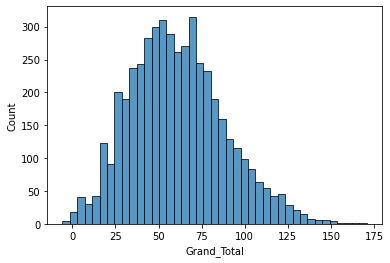

In [ ]:
sns.histplot(x='Grand_Total', data=LobsterLand);


**a. What do you notice about this relationship? In a couple of sentences, how would you describe what you see here?**

*A histogram plot is obtained by distribution of numeric data of grand total againt the invoice numbers. Here a normal distribution( bell curve) can be seen.It clearly indicates majority of the data falls in first standard deviation from the mean.Hence, maximum grand total is observed in the first standard deviation of the plot.*

**b. Now, increase the number of bins. What can you say about this second histogram, compared with the first one?**

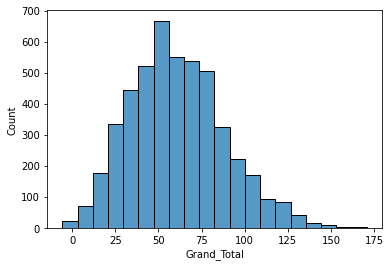

In [ ]:
sns.histplot(x='Grand_Total', bins=20, data=LobsterLand);

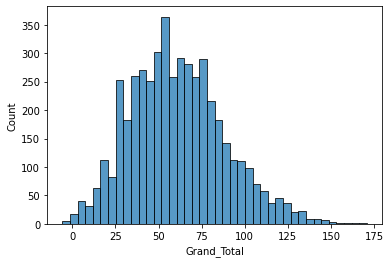

In [ ]:
sns.histplot(x='Grand_Total', bins=40, data=LobsterLand);

*Number of bins affect the histogram plots.Very few bins in the plot makes the visual unrefined and it will not represent the data well.By increasing the bin size, bins are seen quite wide when compared to the first one which can hide important details about the distribution.It evidently hides a small spike in the range of 50 to 75 grand total.*

**L. Which items generated the most total revenue? Generate a bar plot that shows the total revenue for each of the separate merchandise items included in this dataset. Sort the bars in order (tallest to shortest, or shortest to tallest). a. In a sentence or two, what does this plot show?**

In [78]:
category = LobsterLand[['larry_cost','short_tee_cost','long_tee_cost','baseball_hat_cost','bucket_hat_cost','sunglasses_cost']].copy()

In [79]:
category1=category.T

In [80]:
category1

state                 ME    NaN  Other_renamed     VT     MA     MA     RI  \
larry_cost          0.00  29.95           5.99   5.99  11.98   0.00  17.97   
short_tee_cost     23.98  23.98          23.98   0.00  11.99  47.96  23.98   
long_tee_cost      31.98   0.00           0.00   0.00  15.99  31.98   0.00   
baseball_hat_cost  15.99  15.99          15.99   0.00  15.99  15.99  15.99   
bucket_hat_cost    16.99   0.00           0.00   0.00   0.00  16.99   0.00   
sunglasses_cost    17.98   0.00           8.99  17.98   8.99  35.96   0.00   

state                 ME     NY     MA     ME    NaN     ME     ME     VT  \
larry_cost         11.98  17.97   5.99  17.97   5.99  17.97  17.97   5.99   
short_tee_cost      0.00  11.99  11.99   0.00  23.98  11.99  23.98   0.00   
long_tee_cost      15.99  15.99   0.00  31.98   0.00   0.00  15.99   0.00   
baseball_hat_cost   0.00   0.00   0.00   0.00  15.99  15.99  15.99   0.00   
bucket_hat_cost     0.00   0.00   0.00   0.00  16.99   0.00   0.00  16.99   
sunglasses_cost     0.00   0.00  17.98   8.99   8.99   0.00   0.00   8.99   

state                NaN     VT     ME  Other_renamed     NH     MA     RI  \
larry_cost          5.99  11.98   5.99          11.98  29.95   5.99  17.97   
short_tee_cost     11.99  11.99  23.98          23.98   0.00  23.98  35.97   
long_tee_cost       0.00  15.99  15.99          31.98  31.98   0.00   0.00   
baseball_hat_cost   0.00  15.99   0.00           0.00   0.00   0.00   0.00   
bucket_hat_cost     0.00  16.99   0.00           0.00   0.00   0.00   0.00   
sunglasses_cost    35.96   8.99   0.00          26.97  44.95  17.98   8.99   

state              Other_renamed    NaN     MA     NY     VT     ME     NH  \
larry_cost                 11.98   5.99  17.97   0.00   5.99  11.98   5.99   
short_tee_cost             23.98  11.99  11.99  23.98   0.00   0.00  23.98   
long_tee_cost              15.99  31.98  15.99   0.00   0.00  15.99   0.00   
baseball_hat_cost           0.00   0.00  15.99   0.00  31.98  15.99   0.00   
bucket_hat_cost             0.00  16.99   0.00   0.00   0.00   0.00   0.00   
sunglasses_cost            26.97   8.99  35.96  35.96  17.98  17.98   0.00   

state                 MA    NaN     RI     VT     ME     NH    NaN     VT  \
larry_cost          5.99   5.99  23.96   5.99   5.99  11.98  11.98   5.99   
short_tee_cost      0.00  23.98  23.98   0.00  35.97  11.99  11.99  11.99   
long_tee_cost      15.99  15.99   0.00  15.99  31.98  15.99  15.99  15.99   
baseball_hat_cost  15.99  47.97  15.99   0.00  15.99   0.00   0.00   0.00   
bucket_hat_cost     0.00   0.00   0.00   0.00   0.00   0.00   0.00  16.99   
sunglasses_cost    17.98   8.99   0.00   0.00  26.97  17.98   0.00   0.00   

state                 NY     MA     MA     ME    NaN     NY     ME    NaN  \
larry_cost          0.00   5.99  17.97   0.00  17.97  11.98  11.98  11.98   
short_tee_cost     23.98   0.00  23.98  35.97  35.97  11.99   0.00   0.00   
long_tee_cost      15.99   0.00  15.99  63.96   0.00  31.98  15.99   0.00   
baseball_hat_cost   0.00   0.00   0.00   0.00   0.00   0.00   0.00  15.99   
bucket_hat_cost     0.00   0.00  16.99  16.99   0.00   0.00   0.00   0.00   
sunglasses_cost    17.98  26.97  17.98   8.99   8.99   8.99  26.97   8.99   

state                 MA     MA    NaN     VT     ME     NH     MA     ME  \
larry_cost         11.98   0.00  17.97   5.99  11.98   0.00  17.97  17.97   
short_tee_cost     23.98   0.00  35.97  23.98   0.00  11.99  11.99   0.00   
long_tee_cost      15.99   0.00  31.98  47.97   0.00   0.00   0.00   0.00   
baseball_hat_cost  15.99   0.00  15.99  15.99   0.00   0.00   0.00   0.00   
bucket_hat_cost     0.00   0.00   0.00   0.00   0.00   0.00  16.99   0.00   
sunglasses_cost     0.00  17.98   8.99  17.98   8.99   0.00   0.00   8.99   

state                 ME     NH     ME     NY     ME     NY    NaN     ME  \
larry_cost         29.95   0.00   5.99  17.97   0.00  11.98  11.98   5.99   
short_tee_cost     11.99  35.97   0.00  11.99

In [81]:
category1['t_sales']=category1.sum(axis=1)

In [82]:
category1

state                 ME    NaN  Other_renamed     VT     MA     MA     RI  \
larry_cost          0.00  29.95           5.99   5.99  11.98   0.00  17.97   
short_tee_cost     23.98  23.98          23.98   0.00  11.99  47.96  23.98   
long_tee_cost      31.98   0.00           0.00   0.00  15.99  31.98   0.00   
baseball_hat_cost  15.99  15.99          15.99   0.00  15.99  15.99  15.99   
bucket_hat_cost    16.99   0.00           0.00   0.00   0.00  16.99   0.00   
sunglasses_cost    17.98   0.00           8.99  17.98   8.99  35.96   0.00   

state                 ME     NY     MA     ME    NaN     ME     ME     VT  \
larry_cost         11.98  17.97   5.99  17.97   5.99  17.97  17.97   5.99   
short_tee_cost      0.00  11.99  11.99   0.00  23.98  11.99  23.98   0.00   
long_tee_cost      15.99  15.99   0.00  31.98   0.00   0.00  15.99   0.00   
baseball_hat_cost   0.00   0.00   0.00   0.00  15.99  15.99  15.99   0.00   
bucket_hat_cost     0.00   0.00   0.00   0.00  16.99   0.00   0.00  16.99   
sunglasses_cost     0.00   0.00  17.98   8.99   8.99   0.00   0.00   8.99   

state                NaN     VT     ME  Other_renamed     NH     MA     RI  \
larry_cost          5.99  11.98   5.99          11.98  29.95   5.99  17.97   
short_tee_cost     11.99  11.99  23.98          23.98   0.00  23.98  35.97   
long_tee_cost       0.00  15.99  15.99          31.98  31.98   0.00   0.00   
baseball_hat_cost   0.00  15.99   0.00           0.00   0.00   0.00   0.00   
bucket_hat_cost     0.00  16.99   0.00           0.00   0.00   0.00   0.00   
sunglasses_cost    35.96   8.99   0.00          26.97  44.95  17.98   8.99   

state              Other_renamed    NaN     MA     NY     VT     ME     NH  \
larry_cost                 11.98   5.99  17.97   0.00   5.99  11.98   5.99   
short_tee_cost             23.98  11.99  11.99  23.98   0.00   0.00  23.98   
long_tee_cost              15.99  31.98  15.99   0.00   0.00  15.99   0.00   
baseball_hat_cost           0.00   0.00  15.99   0.00  31.98  15.99   0.00   
bucket_hat_cost             0.00  16.99   0.00   0.00   0.00   0.00   0.00   
sunglasses_cost            26.97   8.99  35.96  35.96  17.98  17.98   0.00   

state                 MA    NaN     RI     VT     ME     NH    NaN     VT  \
larry_cost          5.99   5.99  23.96   5.99   5.99  11.98  11.98   5.99   
short_tee_cost      0.00  23.98  23.98   0.00  35.97  11.99  11.99  11.99   
long_tee_cost      15.99  15.99   0.00  15.99  31.98  15.99  15.99  15.99   
baseball_hat_cost  15.99  47.97  15.99   0.00  15.99   0.00   0.00   0.00   
bucket_hat_cost     0.00   0.00   0.00   0.00   0.00   0.00   0.00  16.99   
sunglasses_cost    17.98   8.99   0.00   0.00  26.97  17.98   0.00   0.00   

state                 NY     MA     MA     ME    NaN     NY     ME    NaN  \
larry_cost          0.00   5.99  17.97   0.00  17.97  11.98  11.98  11.98   
short_tee_cost     23.98   0.00  23.98  35.97  35.97  11.99   0.00   0.00   
long_tee_cost      15.99   0.00  15.99  63.96   0.00  31.98  15.99   0.00   
baseball_hat_cost   0.00   0.00   0.00   0.00   0.00   0.00   0.00  15.99   
bucket_hat_cost     0.00   0.00  16.99  16.99   0.00   0.00   0.00   0.00   
sunglasses_cost    17.98  26.97  17.98   8.99   8.99   8.99  26.97   8.99   

state                 MA     MA    NaN     VT     ME     NH     MA     ME  \
larry_cost         11.98   0.00  17.97   5.99  11.98   0.00  17.97  17.97   
short_tee_cost     23.98   0.00  35.97  23.98   0.00  11.99  11.99   0.00   
long_tee_cost      15.99   0.00  31.98  47.97   0.00   0.00   0.00   0.00   
baseball_hat_cost  15.99   0.00  15.99  15.99   0.00   0.00   0.00   0.00   
bucket_hat_cost     0.00   0.00   0.00   0.00   0.00   0.00  16.99   0.00   
sunglasses_cost     0.00  17.98   8.99  17.98   8.99   0.00   0.00   8.99   

state                 ME     NH     ME     NY     ME     NY    NaN     ME  \
larry_cost         29.95   0.00   5.99  17.97   0.00  11.98  11.98   5.99   
short_tee_cost     11.99  35.97   0.00  11.99

In [83]:
category2 = [['larry_cost',57785.53],['short_tee_cost',68990.46],['long_tee_cost',53774.37],['baseball_hat_cost',30524.91],['bucket_hat_cost',20863.72],['sunglasses_cost',49507.93]]


In [84]:
category3= pd.DataFrame(category2,columns=['category','t_sales'])
category3_c = category3.sort_values('t_sales')

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

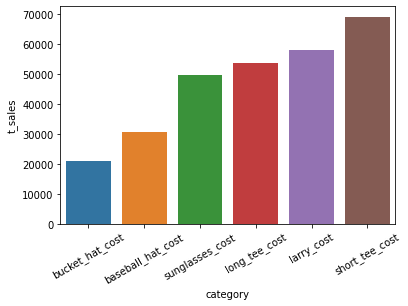

In [85]:
sns.barplot(x='category',y='t_sales',data=category3_c)
plt.xticks(rotation=30, horizontalalignment="center")

*This plot shows that short_tee has maximum amount of sales - $68990*


*whereas, bucket_hat has minimum amount of sales - $20863.72*

**M. Build a violin plot that depicts the distribution of Larry the Lobster spending, per visitor.**

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


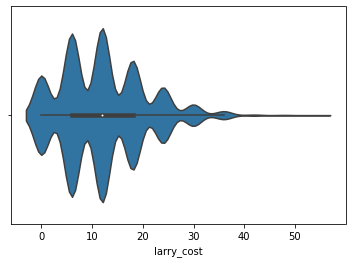

In [6]:
sns.violinplot(LobsterLand.larry_cost, data = LobsterLand)

**a. In a sentence or two, what does this plot show?**

*The above violinplot indicates higher probability of larry cost is between 5 to 15 where as lower probability is around 30. First quartile is around 6 and third quartile is around 23 with a median of 15. It is seen that maximum probability density is concentrated at the median.*

**b. Now, use a boxplot to depict this distribution.**

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


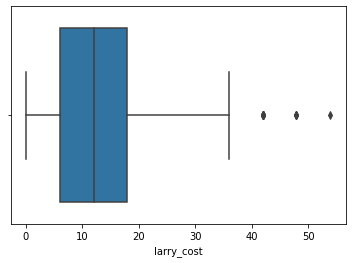

In [7]:
sns.boxplot(LobsterLand.larry_cost,data=LobsterLand)

**c. In a sentence or two, what does this plot show?**

*The above boxplot indicates that minimum value of larry_Cost is 0 and maximum value is 35. First quartile value is of about 6 and median is of about 14. Whereas, the third quartile value is almost 18.Interquartile range lies in between 5 to 18. The values of Outliers is found to be about 35.*

**d. How are boxplots different from violinplots?**

*A violin plot is more informative when compared to simple boxplots. Box plots mainly specify the summary statics such as mean,median and interquartile ranges. Whereas, Violinplots show full distribution of the data. Box plots indicate data points outside the inter-quartile range such as outliers above or below the whiskers whereas violin plots show the whole range of the data*

**N. Filter the dataset to create a new dataframe called ‘rokcan’. rokcan should consist only of invoices that originated either in Korea or Canada.**

In [95]:
LobsterLand_rokcan = LobsterLand[LobsterLand['customer_nation'] == 'ROK']
LobsterLand_rokcan

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
state,,,,,,,,,,,,,,,,,,,,
NaN,109,2,11.98,2,23.98,0,0.00,0,0.00,0,0.00,1,8.99,ROK,0,40,None,44.95,2.47225,47.42225
NaN,170,4,23.96,0,0.00,1,15.99,0,0.00,0,0.00,1,8.99,ROK,0,38,5.75,48.94,2.69170,45.88170
NaN,261,4,23.96,2,23.98,2,31.98,0,0.00,1,16.99,0,0.00,ROK,0,52,1.5,96.91,5.33005,100.74005
NaN,284,4,23.96,1,11.99,2,31.98,2,31.98,0,0.00,2,17.98,ROK,0,61,None,117.89,6.48395,124.37395
NaN,343,2,11.98,3,35.97,3,47.97,1,15.99,0,0.00,3,26.97,ROK,0,36,1.5,138.88,7.63840,145.01840
NaN,407,2,11.98,1,11.99,1,15.99,0,0.00,0,0.00,1,8.99,ROK,1,42,None,48.95,2.69225,51.64225
NaN,476,1,5.99,0,0.00,1,15.99,1,15.99,0,0.00,0,0.00,ROK,0,46,None,37.97,2.08835,40.05835
NaN,527,2,11.98,1,11.99,1,15.99,0,0.00,0,0.00,1,8.99,ROK,0,40,None,48.95,2.69225,51.64225
NaN,567,4,23.96,1,11.99,0,0.00,2,31.98,2,33.98,1,8.99,ROK,0,27,None,110.90,6.09950,116.99950


In [96]:
total_orders = LobsterLand_rokcan.larry_lobs + LobsterLand_rokcan.short_tee + LobsterLand_rokcan.long_tee+ LobsterLand_rokcan.baseball_hat + LobsterLand_rokcan.bucket_hat +LobsterLand_rokcan.sunglasses

LobsterLand_rokcan["total_orders"] = total_orders

LobsterLand_rokcan

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total,total_orders
state,,,,,,,,,,,,,,,,,,,,,
NaN,109,2,11.98,2,23.98,0,0.00,0,0.00,0,0.00,1,8.99,ROK,0,40,None,44.95,2.47225,47.42225,5
NaN,170,4,23.96,0,0.00,1,15.99,0,0.00,0,0.00,1,8.99,ROK,0,38,5.75,48.94,2.69170,45.88170,6
NaN,261,4,23.96,2,23.98,2,31.98,0,0.00,1,16.99,0,0.00,ROK,0,52,1.5,96.91,5.33005,100.74005,9
NaN,284,4,23.96,1,11.99,2,31.98,2,31.98,0,0.00,2,17.98,ROK,0,61,None,117.89,6.48395,124.37395,11
NaN,343,2,11.98,3,35.97,3,47.97,1,15.99,0,0.00,3,26.97,ROK,0,36,1.5,138.88,7.63840,145.01840,12
NaN,407,2,11.98,1,11.99,1,15.99,0,0.00,0,0.00,1,8.99,ROK,1,42,None,48.95,2.69225,51.64225,5
NaN,476,1,5.99,0,0.00,1,15.99,1,15.99,0,0.00,0,0.00,ROK,0,46,None,37.97,2.08835,40.05835,3
NaN,527,2,11.98,1,11.99,1,15.99,0,0.00,0,0.00,1,8.99,ROK,0,40,None,48.95,2.69225,51.64225,5
NaN,567,4,23.96,1,11.99,0,0.00,2,31.98,2,33.98,1,8.99,ROK,0,27,None,110.90,6.09950,116.99950,10


In [97]:
LobsterLand_rokcan1 = LobsterLand[LobsterLand['customer_nation'] == 'CAN']
LobsterLand_rokcan1

total_orders = LobsterLand_rokcan1.larry_lobs + LobsterLand_rokcan1.short_tee + LobsterLand_rokcan1.long_tee+ LobsterLand_rokcan1.baseball_hat + LobsterLand_rokcan1.bucket_hat +LobsterLand_rokcan1.sunglasses


LobsterLand_rokcan1["total_orders"] = total_orders

LobsterLand_rokcan1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total,total_orders
state,,,,,,,,,,,,,,,,,,,,,
NaN,69,1,5.99,1,11.99,1,15.99,0,0.00,0,0.00,3,26.97,CAN,0,40,5.75,60.94,3.35170,58.54170,6
NaN,98,3,17.97,0,0.00,3,47.97,0,0.00,0,0.00,2,17.98,CAN,0,53,None,83.92,4.61560,88.53560,8
NaN,99,2,11.98,1,11.99,2,31.98,0,0.00,0,0.00,2,17.98,CAN,0,34,None,73.93,4.06615,77.99615,7
NaN,176,1,5.99,1,11.99,0,0.00,0,0.00,0,0.00,1,8.99,CAN,0,43,None,26.97,1.48335,28.45335,3
NaN,203,4,23.96,1,11.99,0,0.00,0,0.00,0,0.00,2,17.98,CAN,0,42,None,53.93,2.96615,56.89615,7
NaN,210,3,17.97,0,0.00,1,15.99,0,0.00,2,33.98,1,8.99,CAN,0,56,None,76.93,4.23115,81.16115,7
NaN,229,5,29.95,1,11.99,1,15.99,0,0.00,0,0.00,2,17.98,CAN,0,45,None,75.91,4.17505,80.08505,9
NaN,240,0,0.00,0,0.00,1,15.99,0,0.00,0,0.00,0,0.00,CAN,0,50,None,15.99,0.87945,16.86945,1
NaN,258,0,0.00,2,23.98,1,15.99,0,0.00,0,0.00,1,8.99,CAN,0,41,None,48.96,2.69280,51.65280,4


**a. Use the countplot() function from seaborn to compare the total number of orders from either of these countries. In a sentence or two, what does this plot show?**

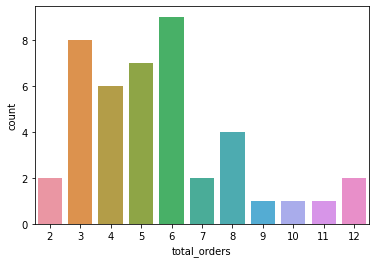

In [98]:
sns.countplot(x="total_orders", data=LobsterLand_rokcan);

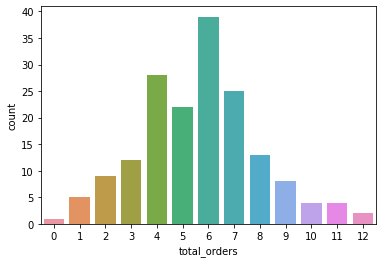

In [99]:
sns.countplot(x="total_orders", data=LobsterLand_rokcan1);

*Countplot 1 indicates the total number of orders in Korea. Whereas,Countplot 2 indicates the total number of orders in Canada. Plot 1 indicates a maximum of 12 items were ordered in two different invoices. Majority of 6 items were ordered in more than 8 invoices. Plot 2 indicates a maximum of 12 items were ordered in less than 5 invoices and a majority of 6 items were ordered in more than 35 invoices. Plot 2 shows a clear normal distribution curve.*

**b. Now, use the barplot() function from seaborn to compare mean spending on long-sleeved t-shirts between Koreans and Canadians. Do not use confidence intervals on this barplot, and use a non-default Seaborn color palette.**

In [100]:
LobsterLand_rokcanm1 = LobsterLand[(LobsterLand['customer_nation'] == 'CAN' )]
LobsterLand_rokcanm1 
LobsterLand_rokcanm2 = LobsterLand[(LobsterLand['customer_nation'] == 'ROK' )]
LobsterLand_rokcanm2

,invoice_num,larry_lobs,larry_cost,short_tee,short_tee_cost,long_tee,long_tee_cost,baseball_hat,baseball_hat_cost,bucket_hat,bucket_hat_cost,sunglasses,sunglasses_cost,customer_nation,LL_passholder,cardholder_age,coupon_disc,purchase_total,MaineSalesTax,Grand_Total
state,,,,,,,,,,,,,,,,,,,,
NaN,109,2,11.98,2,23.98,0,0.00,0,0.00,0,0.00,1,8.99,ROK,0,40,None,44.95,2.47225,47.42225
NaN,170,4,23.96,0,0.00,1,15.99,0,0.00,0,0.00,1,8.99,ROK,0,38,5.75,48.94,2.69170,45.88170
NaN,261,4,23.96,2,23.98,2,31.98,0,0.00,1,16.99,0,0.00,ROK,0,52,1.5,96.91,5.33005,100.74005
NaN,284,4,23.96,1,11.99,2,31.98,2,31.98,0,0.00,2,17.98,ROK,0,61,None,117.89,6.48395,124.37395
NaN,343,2,11.98,3,35.97,3,47.97,1,15.99,0,0.00,3,26.97,ROK,0,36,1.5,138.88,7.63840,145.01840
NaN,407,2,11.98,1,11.99,1,15.99,0,0.00,0,0.00,1,8.99,ROK,1,42,None,48.95,2.69225,51.64225
NaN,476,1,5.99,0,0.00,1,15.99,1,15.99,0,0.00,0,0.00,ROK,0,46,None,37.97,2.08835,40.05835
NaN,527,2,11.98,1,11.99,1,15.99,0,0.00,0,0.00,1,8.99,ROK,0,40,None,48.95,2.69225,51.64225
NaN,567,4,23.96,1,11.99,0,0.00,2,31.98,2,33.98,1,8.99,ROK,0,27,None,110.90,6.09950,116.99950


In [101]:
import scipy;

mean_CAN = print(scipy.mean(LobsterLand_rokcanm1['long_tee_cost']))
mean_ROK = print(scipy.mean(LobsterLand_rokcanm2['long_tee_cost']))

11.806569767441866
10.040232558139538


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  after removing the cwd from sys.path.


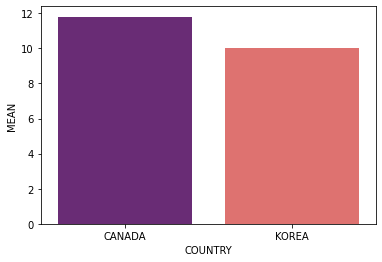

In [102]:
df = pd.DataFrame({'COUNTRY':['CANADA', 'KOREA'], 'MEAN':[11.806569767441866,10.040232558139538 ]})

sns.barplot(x='COUNTRY', y='MEAN', data=df, palette="magma");

*Mean spending of Canada is slighlty more than that of Korea as shown in the barplot.*

**Part III: Wildcard: Metrics and “Quantified Self” (1 point)**

**A. For two days, you will gather observational data, acting as both the researcher AND as the subject.**

**a. Choose any ONE aspect of your daily life that you can quantify. This could be a health metric, a financial metric, an entertainment metric, a metric about a hobby, or just ANYTHING else that you can measure/quantify.**

*I have chosen health metric here. I have decided to track my calories burned in a day and calories consumed in order to identify if it is leading to fat loss or muscle gain or maintenance state.*

**b. For each of the three days, keep track of this metric.**

*I have tracked my calories burned using fitness app in apple watch and myfitnesspal has been used to calculate the calories consumed by logging food in the tracker*

*For an individual weighing 145 lb - 160 lb, 2499kcal results in maintain weight state and 2199kcal leads to mild weight loss and less than that leads to weight loss. Result is obtained by subtracted the amount of calories consumed minus calories burned.*

*Day 1 - Calorie consumed: 2100 kcal, Calories Burned:680 kcal, Result: Mild weight loss*

*Day 2 - Calorie consumed: 1950 kcal, Calories Burned: 715 kcal, Result: Mild weight loss*

*Day 3 - Calorie consumed: 2300 kcal, Calories Burned: 695 kcal, Result: Maintain weight State*

**c. Write ONE thoughtful paragraph about your experience.**

*I have been tracking my workouts from a long time. But I never really logged my food to understand the amount of calories consumed. This was a new experience for me as it helped me realise the importance of macros and a well balanced meal distribution to acheive your goal. Before quantifying this I have always felt that I never consumed calorie dense food. But on tracking each and every individual food item it provided me a better understanding of high or low calorie foods. It has also helped me realise the importance of tracking the calories consumed in a day which gives a clear picture on how to achieve your goal of muscle building or fat loss. By tracking this,it has helped me to alter my food habits and meal choices. Definitely, people around me found it to be weird for logging each and every food item. Personally, I feel it is one of the optimal way to acheive your fitness goal. As consistency is the key to acheive any goal.*